<p><font size="6"><b> Spatial Data Analisis of Civilian Harm in Ukraine</b></font></p>


> *May, 2022*
>
> Oleksandr Pancheliuga | [pancheliuga.com](https://pancheliuga.com)

---

#### *This project aims to extract statistical insights and produce a meaningful cartographic visualization of civilian harm in Ukraine.*

*The data for this project based on incidents in Ukraine that have resulted in potential civilian harm. This data began collection by the OSINT group [Bellingcat](https://www.bellingcat.com/) on February 24, 2022, and intends to be a living document that will continue to be updated as long as the war persists. Therefore, this data is not an exhaustive list of civilian harm in Ukraine but rather a representation of all incidents that Bellingcat has collected and determined the exact locations.*

#### Required modules

In [1]:
import pandas as pd
import geopandas as gpd
import json
import plotly.express as px
import plotly.graph_objects as go
import contextily as cx
import folium
from folium.plugins import HeatMap

# Importing and exploring the data

### Importing json file

In [2]:
fp = 'data/ukr-civharm-2022-05-24.json'

with open(fp, 'r') as file:
     data = json.loads(file.read())

Flatten nested JSON structures to pandas DataFrame

In [3]:
incidents_df = pd.json_normalize(data, record_path='filters', meta=['id', 'date', 'latitude', 'longitude', 'location', 'description'])

In [4]:
incidents_df.head()

,key,value,id,date,latitude,longitude,location,description
0,Type of area affected,Residential,CIV0001,02/24/2022,49.85005,36.659031,"Chuhuiv, south of Kharkiv","Apartment block hit. Crater is very large, pos..."
1,Weapon System,Unknown,CIV0001,02/24/2022,49.85005,36.659031,"Chuhuiv, south of Kharkiv","Apartment block hit. Crater is very large, pos..."
2,Type of area affected,Commercial,CIV0002,02/24/2022,48.748564,30.218515,Uman,Civillians hit by what appears to have been ar...
3,Weapon System,Air strike,CIV0002,02/24/2022,48.748564,30.218515,Uman,Civillians hit by what appears to have been ar...
4,Type of area affected,Healthcare,CIV0004,02/24/2022,47.775537,37.239601,Vuhledar,"Explosion in central Kyiv, nothing further yet."


### Data munging

In [5]:
incidents_df = incidents_df[incidents_df['key'] == 'Type of area affected'].rename(columns={'value': 'area_type'}).reset_index()

In [6]:
columns = [
    'id', 
    'date', 
    'latitude', 
    'longitude', 
    'location', 
    'area_type', 
    'description'
]

In [7]:
incidents_df = incidents_df[columns]

In [8]:
incidents_df[["latitude", "longitude"]] = incidents_df[["latitude", "longitude"]].apply(pd.to_numeric)

In [9]:
incidents_df['date'] = pd.to_datetime(incidents_df['date'])

### Exploring the data

In [10]:
incidents_df.head()

,id,date,latitude,longitude,location,area_type,description
0,CIV0001,2022-02-24,49.850050,36.659031,"Chuhuiv, south of Kharkiv",Residential,"Apartment block hit. Crater is very large, pos..."
1,CIV0002,2022-02-24,48.748564,30.218515,Uman,Commercial,Civillians hit by what appears to have been ar...
2,CIV0004,2022-02-24,47.775537,37.239601,Vuhledar,Healthcare,"Explosion in central Kyiv, nothing further yet."
3,CIV0007,2022-02-24,46.227890,34.642830,Semihatka/Henichesk,Undefined,Corpse of a child wrapped in a blanket near th...
4,CIV0008,2022-02-24,47.116736,37.684468,Mariupol,Residential,Civillian homes hit by artillery.


In [11]:
incidents_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 456 entries, 0 to 455
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   id           456 non-null    object        
 1   date         456 non-null    datetime64[ns]
 2   latitude     456 non-null    float64       
 3   longitude    456 non-null    float64       
 4   location     456 non-null    object        
 5   area_type    456 non-null    object        
 6   description  456 non-null    object        
dtypes: datetime64[ns](1), float64(2), object(4)
memory usage: 25.1+ KB


# Statistical analisis

### Analysing civilian harm by type of affected area

In [12]:
incidents_by_type = incidents_df.groupby('area_type').size()

In [13]:
incidents_by_type = incidents_by_type.to_frame(name='n_events').reset_index()

In [14]:
incidents_by_type.sort_values(by='n_events', ascending=False)

,area_type,n_events
7,Residential,200
1,Commercial,52
9,Undefined,49
8,School or childcare,43
4,Industrial,35
3,Healthcare,32
0,Administrative,20
6,Religious,17
2,Cultural,7
5,Military,1


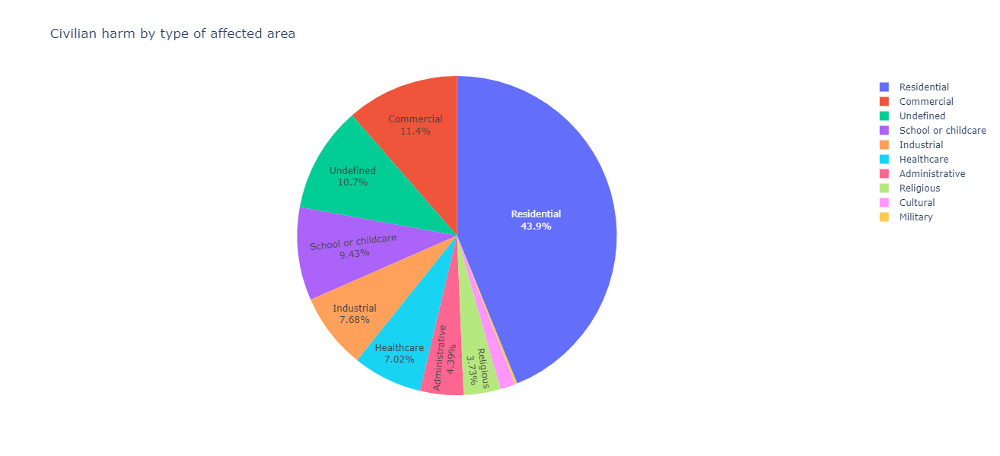

In [15]:
fig = px.pie(incidents_by_type, values='n_events', names='area_type', title='Civilian harm by type of affected area', 
             hover_data=['n_events'], labels={'n_events':'Number of incidents'})

fig.update_traces(textposition='inside', textinfo='percent+label')
fig.update_layout(uniformtext_minsize=12, uniformtext_mode='hide', width=800, height=600)

fig.show()

### Analysing civilian harm by date

In [16]:
incidents_by_day = incidents_df.groupby('date').size().to_frame(name='n_events').reset_index()

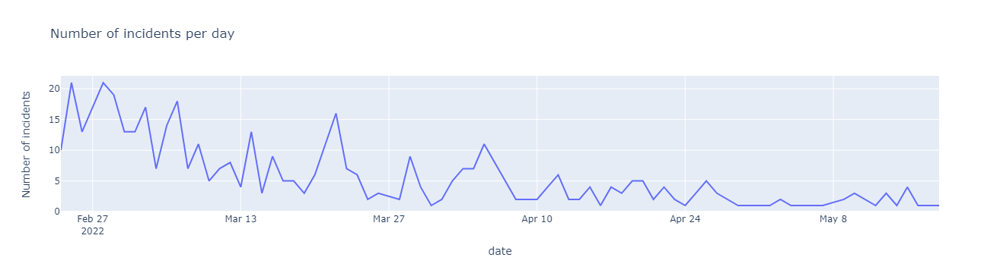

In [17]:
fig = px.line(incidents_by_day, x='date', y='n_events', title='Number of incidents per day', labels={'n_events':'Number of incidents'})

fig.show()

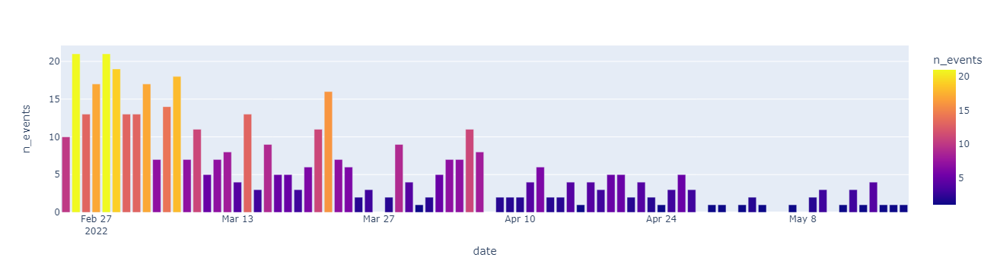

In [18]:
fig = px.bar(incidents_by_day, x='date', y='n_events', color='n_events')

fig.show()

# Geospatial dimension

### Converting to a geospatial dataset

In [19]:
geo_incidents_df = gpd.GeoDataFrame(incidents_df, geometry=gpd.points_from_xy(incidents_df['longitude'], incidents_df['latitude']), crs="EPSG:4326")

In [20]:
geo_incidents_df.to_crs(epsg=3857, inplace=True)

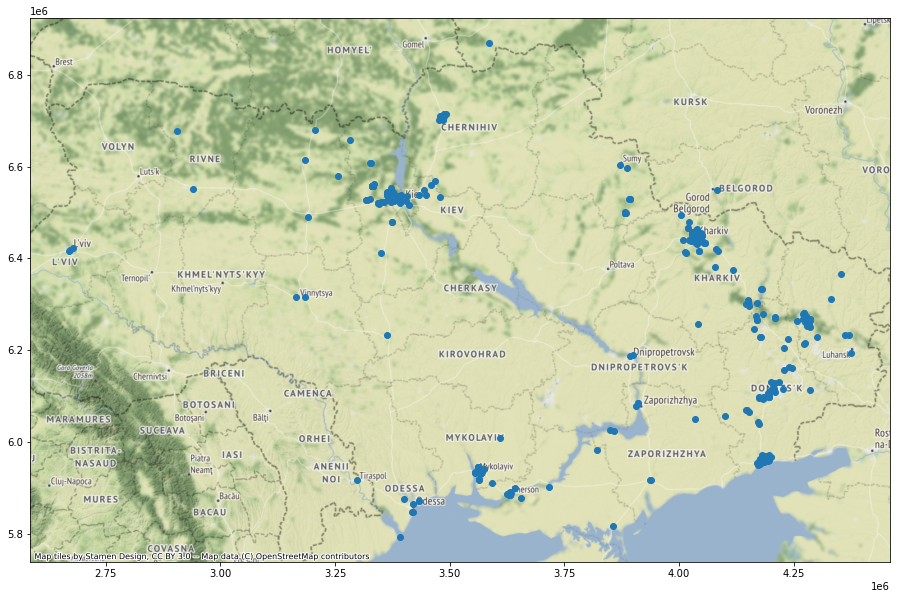

In [21]:
ax = geo_incidents_df.plot(figsize=(20,10))
cx.add_basemap(ax)

From the map above, we can define that few points are outside Ukraine.

### Combining with regions of Ukraine

I downloaded the publicly available regions reference from humdata.org ([Ukraine - Subnational Administrative Boundaries](https://data.humdata.org/dataset/cod-ab-ukr?force_layout=desktop)), and added the Shapefile with the borders to the project repo: `data/ukr-adm-sspe-20220131-zip-1/ukr_admbnda_adm1_sspe_20220114.shp`.

In [22]:
regions = gpd.read_file(r'data/ukr-adm-sspe-20220131-zip-1/ukr_admbnda_adm1_sspe_20220114.shp')

In [23]:
regions.head(3)

,Shape_Leng,Shape_Area,ADM1_EN,ADM1_UA,ADM1_RU,ADM1_PCODE,ADM1_REF,ADM1ALT1EN,ADM1ALT2EN,ADM1ALT1UA,...,ADM1ALT1RU,ADM1ALT2RU,ADM0_EN,ADM0_UA,ADM0_RU,ADM0_PCODE,date,validOn,validTo,geometry
0,25.522335,2.931510,Avtonomna Respublika Krym,Автономна Республіка Крим,Автономная Республика Крым,UA01,None,None,None,None,...,None,None,Ukraine,Україна,Украина,UA,2021-11-09,2022-01-14,None,"MULTIPOLYGON (((35.37597 45.26085, 35.37507 45..."
1,12.326361,3.250424,Vinnytska,Вінницька,Винницкая,UA05,None,None,None,None,...,None,None,Ukraine,Україна,Украина,UA,2021-11-09,2022-01-14,None,"POLYGON ((28.87952 49.88847, 28.88087 49.88828..."
2,12.448772,2.590782,Volynska,Волинська,Волынская,UA07,None,None,None,None,...,None,None,Ukraine,Україна,Украина,UA,2021-11-09,2022-01-14,None,"POLYGON ((25.22584 51.96091, 25.22584 51.96091..."


In [24]:
regions.to_crs(epsg=3857, inplace=True)

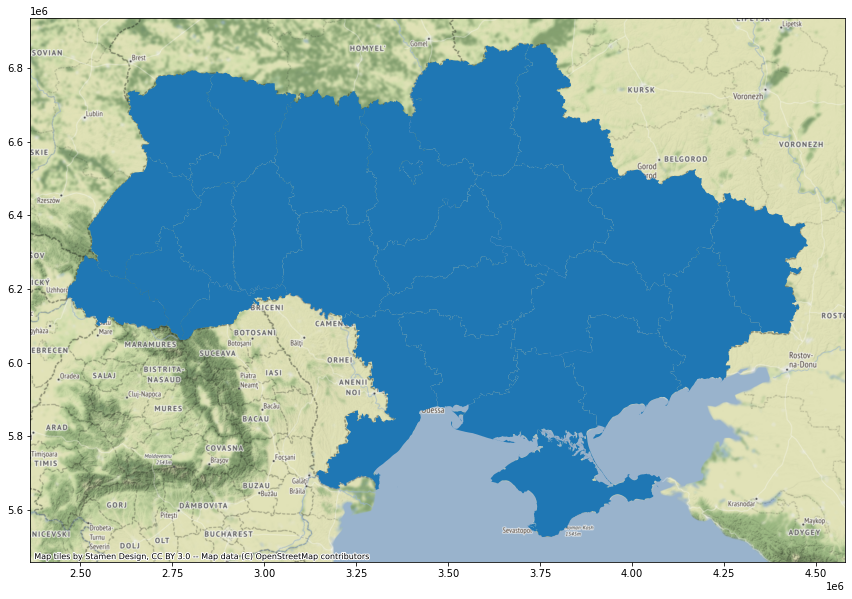

In [25]:
ax = regions.plot(figsize=(20,10))
cx.add_basemap(ax)

In [26]:
geo_incidents_df.crs == regions.crs

True

In [27]:
combined_geo_incidents_df = gpd.sjoin(geo_incidents_df, regions[['ADM1_EN', 'geometry']], predicate='within').drop(columns=['index_right'])

In [28]:
combined_geo_incidents_df.head(3)

,id,date,latitude,longitude,location,area_type,description,geometry,ADM1_EN
0,CIV0001,2022-02-24,49.850050,36.659031,"Chuhuiv, south of Kharkiv",Residential,"Apartment block hit. Crater is very large, pos...",POINT (4080864.664 6420347.527),Kharkivska
12,CIV0018,2022-02-25,49.987116,36.261098,Kharkiv,Residential,Rocket motor lodged in a street at zebra cross...,POINT (4036566.965 6444044.858),Kharkivska
13,CIV0019,2022-02-25,49.990482,36.267443,Kharkiv,Residential,Another weapon remnant (also possibly from a B...,POINT (4037273.287 6444627.654),Kharkivska


## Heatmap visualization

In [29]:
m = folium.Map(location=[49.107892273527504, 31.444630060047018], tiles = 'stamentoner', zoom_start=6, control_scale=True)

heat_data = list(zip(combined_geo_incidents_df["latitude"], combined_geo_incidents_df["longitude"]))

HeatMap(heat_data).add_to(m)

m

### Analysing civilian harm by regions

In [30]:
incidents_by_region = combined_geo_incidents_df.groupby('ADM1_EN').size().to_frame(name='n_events').reset_index()

In [31]:
incidents_by_region.head(2)

,ADM1_EN,n_events
0,Cherkaska,1
1,Chernihivska,14


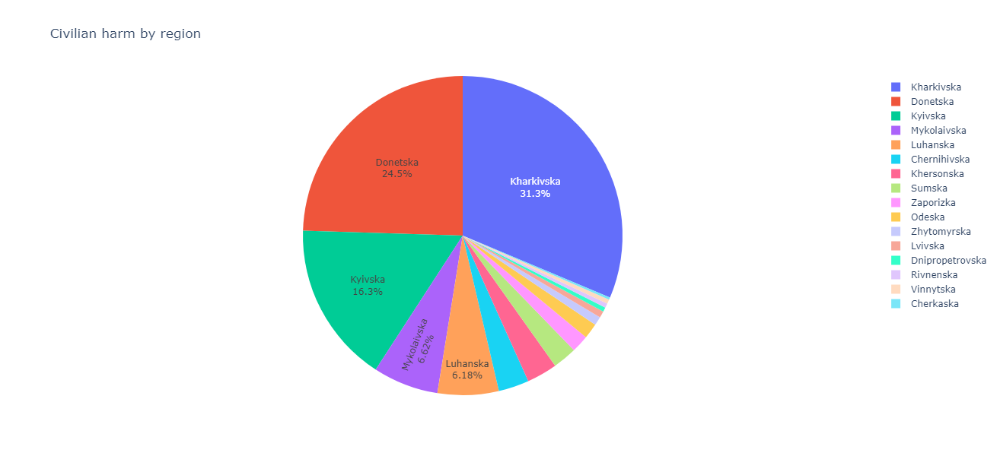

In [32]:
fig = px.pie(incidents_by_region, values='n_events', names='ADM1_EN', title='Civilian harm by region', 
             hover_data=['n_events'], labels={'n_events':'Number of incidents', 'ADM1_EN': 'Region'})

fig.update_traces(textposition='inside', textinfo='percent+label')
fig.update_layout(uniformtext_minsize=12, uniformtext_mode='hide', width=800, height=600)

fig.show()

## Choropleth classification

In [33]:
regions_incidents = pd.merge(regions[['ADM1_EN', 'geometry']], incidents_by_region, how='left', on='ADM1_EN')

In [34]:
regions_incidents['n_events'] = regions_incidents['n_events'].fillna(0)

In [35]:
regions_incidents.head()

,ADM1_EN,geometry,n_events
0,Avtonomna Respublika Krym,"MULTIPOLYGON (((3938035.422 5662681.206, 39379...",0.0
1,Vinnytska,"POLYGON ((3214853.149 6426982.914, 3215003.413...",2.0
2,Volynska,"POLYGON ((2808127.132 6793060.793, 2808127.175...",0.0
3,Dnipropetrovska,"POLYGON ((3890426.290 6307427.251, 3890433.761...",2.0
4,Donetska,"POLYGON ((4215911.333 6315274.555, 4215968.591...",111.0


In [36]:
regions_incidents['geoid'] = regions_incidents.index.astype(str)

In [37]:
m = folium.Map(location=[49.107892273527504, 31.444630060047018], tiles='cartodbpositron', zoom_start=6, control_scale=True)

folium.Choropleth(geo_data=regions_incidents, 
                  data=regions_incidents,
                  name='Choropleth Map',
                  columns=['geoid','n_events'], 
                  key_on='feature.id',
                  bins=8,
                  fill_color='YlOrRd', 
                  line_color='white',
                  line_weight=0,
                  legend_name='Number of incidents').add_to(m)

folium.features.GeoJson(regions_incidents, name='Labels',
               style_function=lambda x: {'color':'transparent','fillColor':'transparent','weight':0},
                tooltip=folium.features.GeoJsonTooltip(fields=['ADM1_EN', 'n_events'],
                                              aliases = ['Region', 'Number of incidents'],
                                              labels=True,
                                              sticky=True)).add_to(m)

folium.LayerControl().add_to(m)

m